# Clustering of all data

Read in all necessary packages:

In [11]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from pandas.io.parsers import read_csv
import scvelo as scv
import scanpy as sc
import numpy as np
from functools import reduce
from anndata import AnnData, read_h5ad
import singlecellmultiomics.bamProcessing.bamToRNACounts
import loompy
import collections

In [12]:
scv.settings.verbosity = 3 # show errors(0), warnings(1), info(2), hints(3)
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

scv.settings.presenter_view = True  # set max width size for presenter view
sc.set_figure_params(dpi=100, color_map = 'viridis')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.19.2 scipy==1.8.0 pandas==1.4.1 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.9 pynndescent==0.5.6


# Load the dataset

In [13]:
pwd

'/Users/m.blotenburg/Documents/Projects/TCHIC/data/jupyter_notebooks/2023'

In [14]:
#import loom in adata
adata = scv.read_loom('/Users/m.blotenburg/Documents/Projects/TCHIC/data/jupyter_notebooks/2023/data/20230619_allGastruloids.loom',obs_names='CellID')
adata

AnnData object with n_obs × n_vars = 46064 × 54078
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

reformat and add categories to adata.obs

In [15]:
adata.var['gene'] = adata.var.index
adata.var

,Accession,Chromosome,End,Start,Strand,gene
Gene,,,,,,
Xkr4,ENSMUSG00000051951,1,3671498,3205901,-,Xkr4
Gm37180,ENSMUSG00000103377,1,3368549,3365731,-,Gm37180
Gm37363,ENSMUSG00000104017,1,3377788,3375556,-,Gm37363
Gm37686,ENSMUSG00000103025,1,3467285,3464977,-,Gm37686
Gm37329,ENSMUSG00000103201,1,3514507,3512451,-,Gm37329
...,...,...,...,...,...,...
Gm20879,ENSMUSG00000100246,Y,90000411,89999717,+,Gm20879
Gm29504,ENSMUSG00000100533,Y,90277501,90275224,+,Gm29504
Gm20837,ENSMUSG00000096178,Y,90433263,90401248,+,Gm20837


In [16]:
batches = [ob.split(':')[0] for ob in adata.obs_names]
batches = [sub.replace('E85', 'E8.5-repa') for sub in batches]
days = [ob.split('-')[3] for ob in batches]
reps = [ob.split('-')[4] for ob in batches]
marks = [ob.split('-')[5] for ob in batches]

adata.obs['batch2'] = [ob.rsplit('-',1)[0] for ob in batches]
adata.obs['batch'] = batches 
adata.obs['day'] = days
adata.obs['replicates'] = reps 
adata.obs['mark'] = marks 
adata.obs['day_rep'] = adata.obs['day'].astype(str) + '_' + adata.obs['replicates'].astype(str)

adata.obs['dataset'] = 'old'
adata.obs['batch'] = adata.obs['batch'].astype(str)
adata.obs['batch2'] = adata.obs['batch2'].astype(str)
adata.obs['dataset'] = adata.obs['dataset'].astype(str)

adata.obs.loc[adata.obs['batch2'] == 'PZ-MB-TChIC-Gastd6-rep3-H3K27me3', 'dataset'] = 'OUD8207'
adata.obs.loc[adata.obs['batch2'] == 'PZ-MB-TChIC-Gastd7-rep3-H3K4me3', 'dataset'] = 'OUD8207'
adata.obs.loc[adata.obs['batch2'] == 'PZ-MB-TChIC-Gastd7-rep3-H3K27me3', 'dataset'] = 'OUD8207'
adata.obs.loc[adata.obs['batch2'] == 'PZ-MB-TChIC-Gastd5-rep3-H3K4me3', 'dataset'] = 'OUD8208'
adata.obs.loc[adata.obs['batch'] == 'PZ-MB-TChIC-Gastd4-rep3-H3K4me3-7', 'dataset'] = 'OUD8208'
adata.obs.loc[adata.obs['batch'] == 'PZ-MB-TChIC-Gastd4-rep3-H3K4me3-8', 'dataset'] = 'OUD8208'
adata.obs.loc[adata.obs['batch'] == 'PZ-MB-TChIC-Gastd4-rep3-H3K4me3-9', 'dataset'] = 'OUD8208'
adata.obs.loc[adata.obs['batch'] == 'PZ-MB-TChIC-Gastd4-rep3-H3K4me3-10', 'dataset'] = 'OUD8208'
adata.obs.loc[adata.obs['batch'] == 'PZ-MB-TChIC-Gastd4-rep3-H3K4me3-11', 'dataset'] = 'OUD8208'
adata.obs.loc[adata.obs['batch'] == 'PZ-MB-TChIC-Gastd4-rep3-H3K4me3-12', 'dataset'] = 'OUD8208'
adata.obs.loc[adata.obs['batch2'] == 'PZ-MB-TChIC-Gastd6-rep3-H3K4me3', 'dataset'] = 'OUD8209'

annot = sc.queries.biomart_annotations("mmusculus",
                                       ['external_gene_name','gene_biotype'],
                                      ).set_index("external_gene_name")
annot = annot[~annot.index.duplicated(keep='first')]

adata.var[annot.columns] = annot
adata.var['gene_biotype'] = pd.Categorical(adata.var['gene_biotype'])
adata.var['gene_biotype'] = adata.var['gene_biotype'].cat.add_categories('Unknown')
adata.var['gene_biotype'] = adata.var['gene_biotype'].fillna('Unknown')

In [17]:
len(adata.obs['batch'].unique())

120

In [19]:
barcodes = pd.read_csv("/Users/m.blotenburg/Documents/Projects/Helena/data/VASAbarcodes.csv", sep = '\t', header = None, index_col=0, squeeze=True).to_dict()
barcodes = {y:x for x,y in barcodes.items()}
adata.obs['cellnames'] = ['-'.join(x) for x in [ob.split('-')[0:7] for ob in adata.obs.index]]
adata.obs['bc'] = [ob.split(':')[1] for ob in adata.obs['cellnames']]
adata.obs['bc'] = adata.obs['bc'].map(lambda x: barcodes[x])
adata.obs['cellname'] = adata.obs['batch'].astype(str) + '_' + adata.obs['bc'].astype(str)
adata.obs.index = adata.obs['cellname']
adata.obs.index.rename('index')
adata.obs.index = adata.obs.index.rename('index')
adata.obs.head(2)


,batch2,batch,day,replicates,mark,day_rep,dataset,cellnames,bc,cellname
index,,,,,,,,,,
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_341,PZ-MB-TChIC-Gastd5-rep2-H3K27me3,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1,Gastd5,rep2,H3K27me3,Gastd5_rep2,old,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1:AACCTGCT,341,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_341
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_310,PZ-MB-TChIC-Gastd5-rep2-H3K27me3,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1,Gastd5,rep2,H3K27me3,Gastd5_rep2,old,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1:AATGGTGG,310,PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_310


remove plates with bad chic signal

In [20]:
remove_plates = ['PZ-MB-TChIC-Gastd3-rep4-H3K27me3-1',
 'PZ-MB-TChIC-Gastd3-rep4-H3K27me3-2',
 'PZ-MB-TChIC-Gastd3-rep4-H3K27me3-3',
 'PZ-MB-TChIC-Gastd3-rep4-H3K27me3-4',
 'PZ-MB-TChIC-Gastd3-rep4-H3K27me3-5',
 'PZ-MB-TChIC-Gastd3-rep4-H3K27me3-6',
 'PZ-MB-TChIC-Gastd3-rep4-H3K4me3-1',
 'PZ-MB-TChIC-Gastd3-rep4-H3K4me3-2',
 'PZ-MB-TChIC-Gastd3-rep4-H3K4me3-3',
 'PZ-MB-TChIC-Gastd3-rep4-H3K4me3-4',
 'PZ-MB-TChIC-Gastd3-rep4-H3K4me3-5',
 'PZ-MB-TChIC-Gastd3-rep4-H3K4me3-6']

adata = adata[~adata.obs['batch'].isin(remove_plates)]

In [21]:
adata

View of AnnData object with n_obs × n_vars = 46064 × 54078
    obs: 'batch2', 'batch', 'day', 'replicates', 'mark', 'day_rep', 'dataset', 'cellnames', 'bc', 'cellname'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene', 'gene_biotype'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [22]:
# define a file to write results to
results_file = '20230619_allGastruloids.h5ad'  # the file that will store the analysis results

# Scanpy

## Preprocessing of dataset 

Check the amount of spliced/unspliced reads in the data.

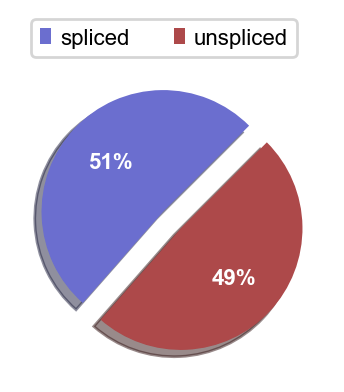

In [23]:
scv.pl.proportions(adata)

In [24]:
#Make names unique
adata.var_names_make_unique()

Show those genes that yield the highest fraction of counts in each single cells, across all cells.

normalizing counts per cell
    finished (0:00:03)


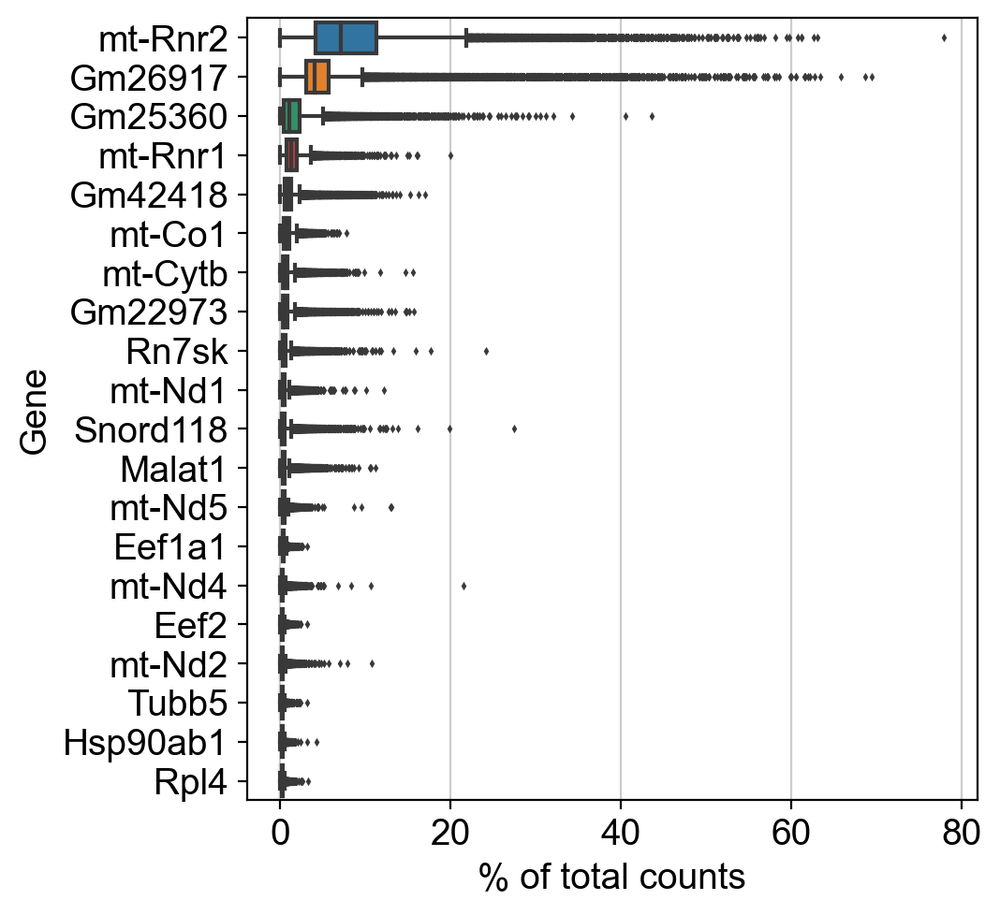

In [25]:
sc.pl.highest_expr_genes(adata, n_top=20)

Basic filtering. You can play around with these cut-offs to see what works best.

In [26]:
adata

AnnData object with n_obs × n_vars = 46064 × 54078
    obs: 'batch2', 'batch', 'day', 'replicates', 'mark', 'day_rep', 'dataset', 'cellnames', 'bc', 'cellname'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene', 'gene_biotype'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

Let us assemble some information about mitochondrial genes, gene biotype and other measures which are important for quality control.



Note you can also use the function `pp.calculate_qc_metrics` to compute the fraction of mitochondrial genes and additional measures.

In [27]:
mito_genes = adata.var_names.str.startswith('mt-')

# for each cell compute fraction of counts in mito genes vs. all genes
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1) / np.sum(adata.X, axis=1)
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1)
adata.obs['n_counts_proteincoding'] = adata[:,list(adata.var[adata.var['gene_biotype'] == 'protein_coding'].index)].X.sum(axis=1)

stress_genes = ['Junb','Fosb','Fos','Hspa1a','Hspa1b','Jun','Hspa8','Hsp90ab1','Hspb1','Egr1','Hsp90aa1','Zfp36','Cebpd','Jund','Hspe1','Atf3','Socs3']


all_stress_genes = [x for x in stress_genes if x in adata.var_names]
all_stress_genes
adata.obs['n_counts_stressgenes'] = adata[:,all_stress_genes].X.sum(axis=1)



In [28]:
adata.var#['Chromosome'].value_counts()

,Accession,Chromosome,End,Start,Strand,gene,gene_biotype
Gene,,,,,,,
Xkr4,ENSMUSG00000051951,1,3671498,3205901,-,Xkr4,protein_coding
Gm37180,ENSMUSG00000103377,1,3368549,3365731,-,Gm37180,TEC
Gm37363,ENSMUSG00000104017,1,3377788,3375556,-,Gm37363,TEC
Gm37686,ENSMUSG00000103025,1,3467285,3464977,-,Gm37686,TEC
Gm37329,ENSMUSG00000103201,1,3514507,3512451,-,Gm37329,TEC
...,...,...,...,...,...,...,...
Gm20879,ENSMUSG00000100246,Y,90000411,89999717,+,Gm20879,unprocessed_pseudogene
Gm29504,ENSMUSG00000100533,Y,90277501,90275224,+,Gm29504,lncRNA
Gm20837,ENSMUSG00000096178,Y,90433263,90401248,+,Gm20837,protein_coding


A violin plot of the computed quality measures.

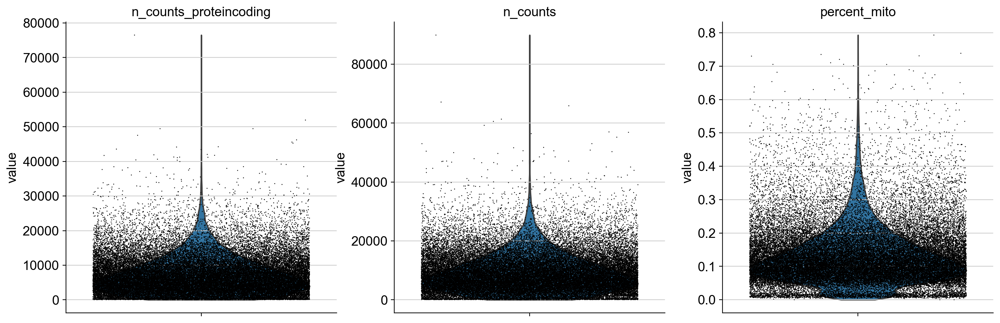

In [29]:
sc.pl.violin(adata, ['n_counts_proteincoding', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

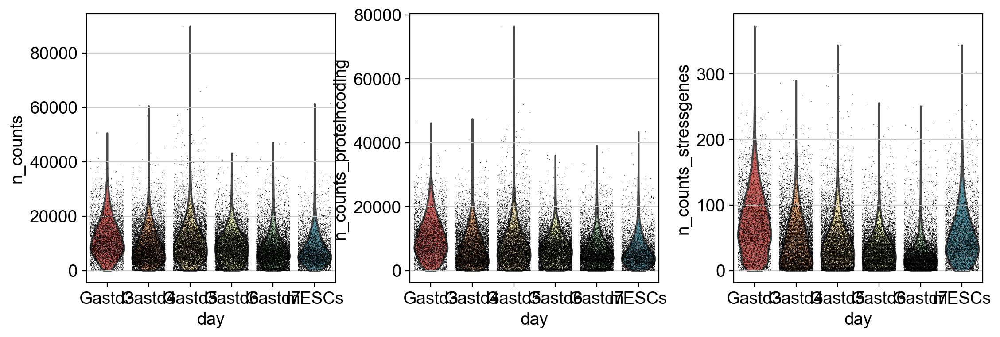

In [30]:
sc.pl.violin(adata, ['n_counts','n_counts_proteincoding','n_counts_stressgenes'], groupby = 'day',palette = 'Spectral',size = 0.5,alpha = 0.5,
             jitter=0.4, multi_panel=True)

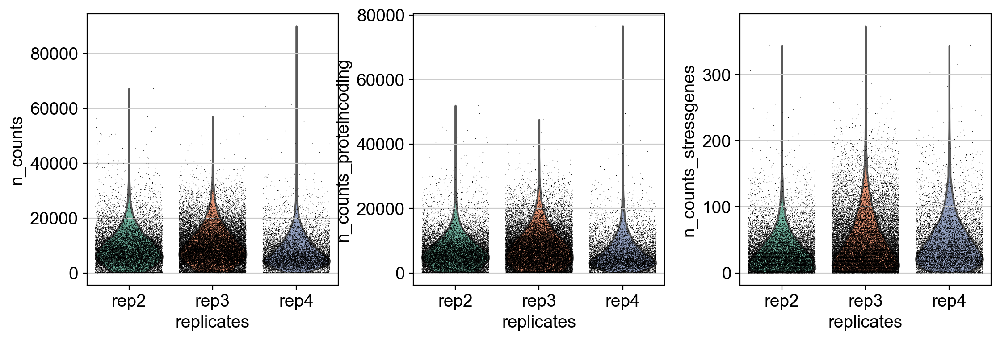

In [31]:
sc.pl.violin(adata, ['n_counts','n_counts_proteincoding','n_counts_stressgenes'], groupby = 'replicates',palette = 'Set2',size = 0.5,alpha = 0.5,
             jitter=0.4, multi_panel=True)

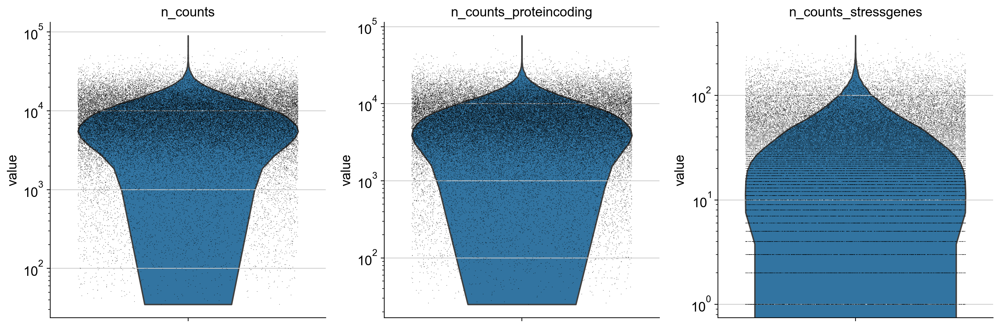

In [32]:
sc.pl.violin(adata, ['n_counts','n_counts_proteincoding','n_counts_stressgenes'], log = True,size = 0.5,alpha = 0.5,
             jitter=0.4, multi_panel=True)

In [33]:
adata.var['gene_counts'] = adata.X.toarray().sum(axis=0)

In [34]:
adata.X.toarray().sum(axis=0)[adata.var['Chromosome'] == '1'].sum()

34113364.0

In [41]:
(adata.obs['dataset'].value_counts())

old        32240
OUD8207     6912
OUD8208     4608
OUD8209     2304
Name: dataset, dtype: int64

In [42]:
(adata.obs['day'].value_counts())

Gastd6    9216
Gastd7    9213
Gastd5    9211
Gastd4    9209
Gastd3    4608
mESCs     4607
Name: day, dtype: int64

In [43]:
(adata.obs['replicates'].value_counts())

rep3    23805
rep2    13818
rep4     8441
Name: replicates, dtype: int64

In [44]:
# calculate total number of counts per gene
adata.var['gene_counts'] = adata.X.toarray().sum(axis=0)
adata.var.head(2)

,Accession,Chromosome,End,Start,Strand,gene,gene_biotype,gene_counts
Gene,,,,,,,,
Xkr4,ENSMUSG00000051951,1,3671498,3205901,-,Xkr4,protein_coding,7445.0
Gm37180,ENSMUSG00000103377,1,3368549,3365731,-,Gm37180,TEC,0.0


### plot counts per gene, separated by biotype

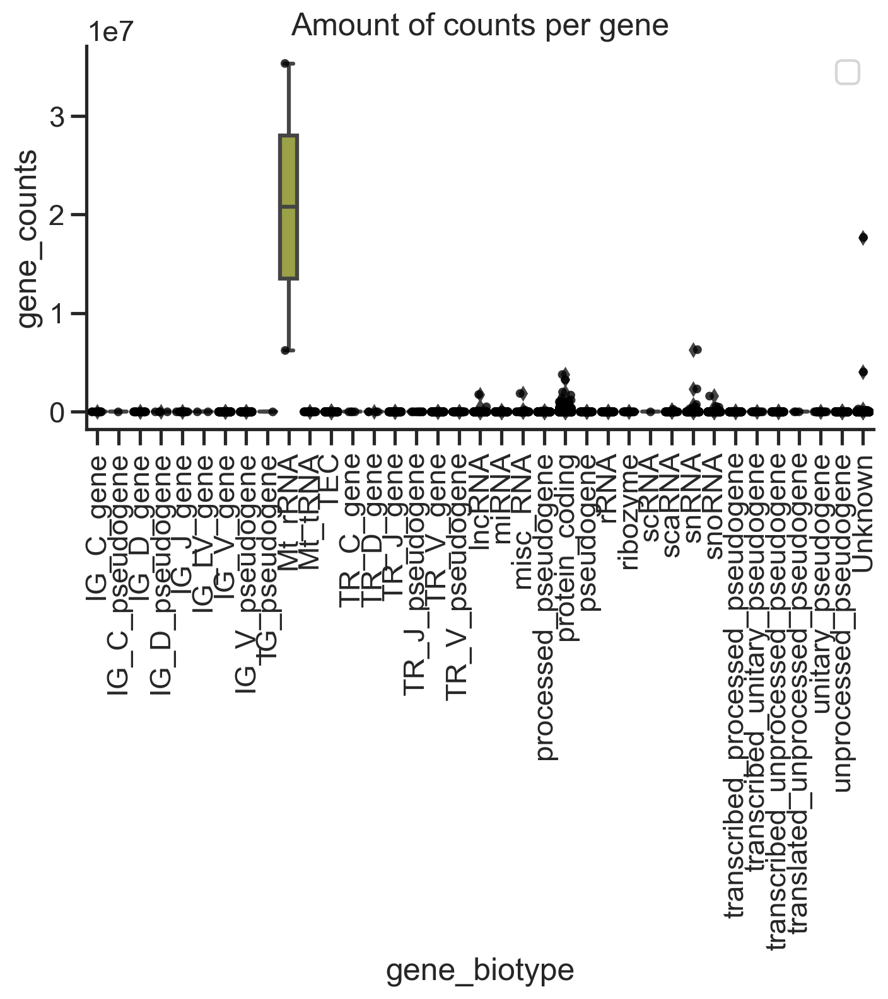

In [47]:
fig, ax = plt.subplots(figsize=(8,4))

sns.boxplot(x = adata.var['gene_biotype'], y = adata.var['gene_counts'], ax=ax)
sns.stripplot(x = adata.var['gene_biotype'], y = adata.var['gene_counts'], ax=ax, color = 'black',
              dodge = True, jitter=0.3, marker='o', alpha=0.8, size = 5)
plt.legend([])
sns.despine()
plt.title('Amount of counts per gene')
ax.tick_params(axis='x', rotation=90)
#ax.set_ylim([-20,300])
#ax.set_yscale('log')

In [48]:
histones = adata.var.filter(regex=r'Hist', axis=0).index
len(adata.var.filter(regex=r'Hist', axis=0).index)


69

In [49]:
banned = ['NA', 'mt-', "Malat1","Rpl",'Rps','Snor']#'Gm']
keptGenes = [geneName for geneName in adata.var.index if not any( (b in geneName for b in banned) )]
bannedGenes = [geneName for geneName in adata.var.index if any( (b in geneName for b in banned) )]

print('kept: ' + str(len(keptGenes)))
print('banned: ' +str(len(bannedGenes)))


kept: 53789
banned: 289


In [50]:
adata.var['gene_counts'] = adata.X.toarray().sum(axis=0)

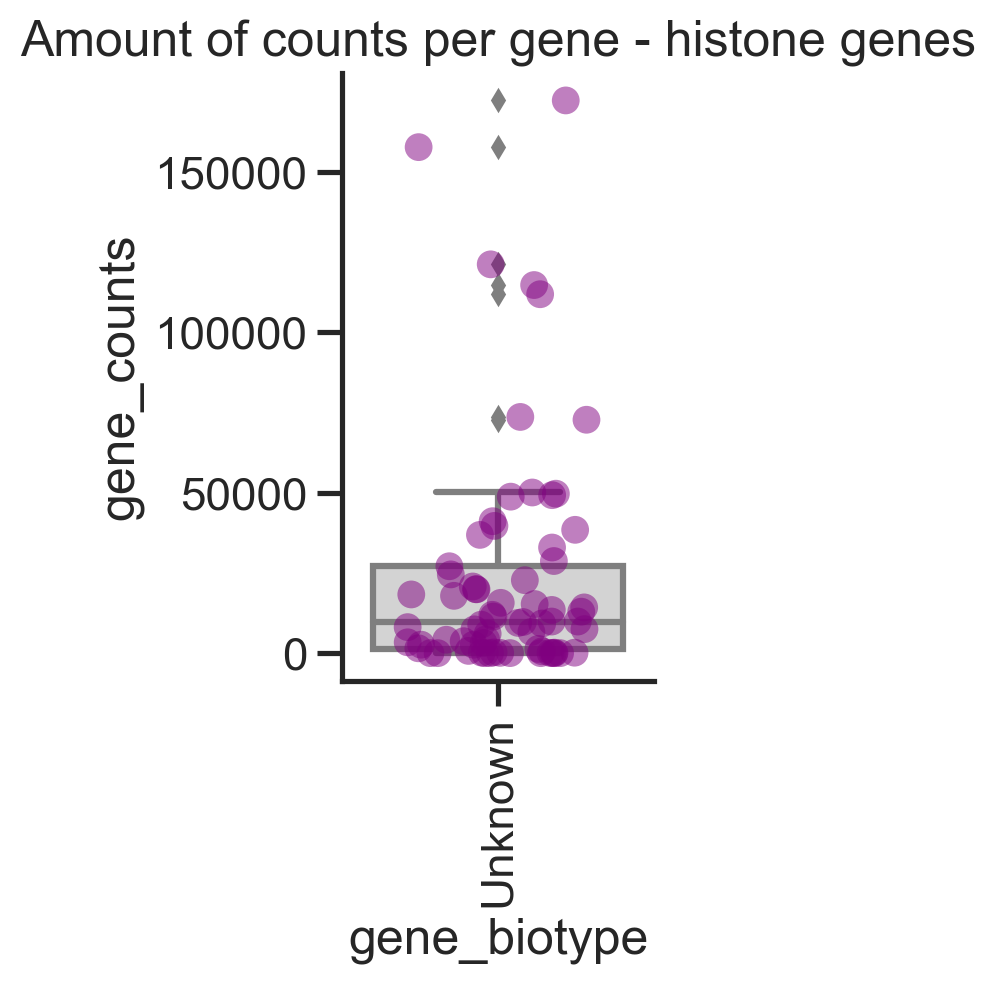

In [51]:
fig, ax = plt.subplots(figsize=(2,4))

sns.boxplot(x = adata[:,histones].var['gene_biotype'], 
            y = adata[:,histones].var['gene_counts'], 
            ax=ax, palette = ['lightgrey'])
plt.legend([])

sns.stripplot(x = adata[:,histones].var['gene_biotype'], 
            y = adata[:,histones].var['gene_counts'],  ax=ax, color = 'purple',
              dodge = True, jitter=0.3, marker='o', alpha=0.5, size = 10)
plt.legend([], frameon=False)

sns.despine()
plt.title('Amount of counts per gene - histone genes')
ax.tick_params(axis='x', rotation=90)

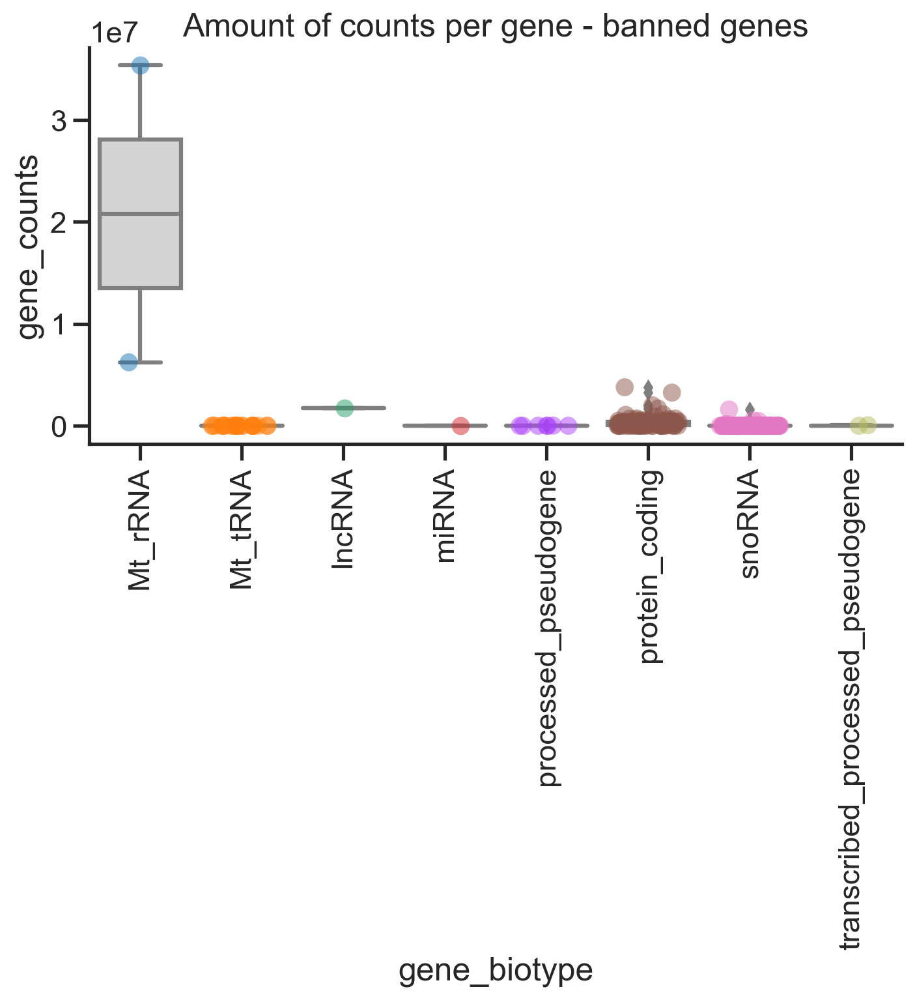

In [52]:
fig, ax = plt.subplots(figsize=(8,4))

sns.boxplot(x = adata[:,bannedGenes].var['gene_biotype'], 
            y = adata[:,bannedGenes].var['gene_counts'], 
            ax=ax, palette = ['lightgrey'])
plt.legend([])

sns.stripplot(x = adata[:,bannedGenes].var['gene_biotype'], 
            y = adata[:,bannedGenes].var['gene_counts'],  ax=ax,
              dodge = True, jitter=0.3, marker='o', alpha=0.5, size = 10)
plt.legend([], frameon=False)

sns.despine()
plt.title('Amount of counts per gene - banned genes')
ax.tick_params(axis='x', rotation=90)

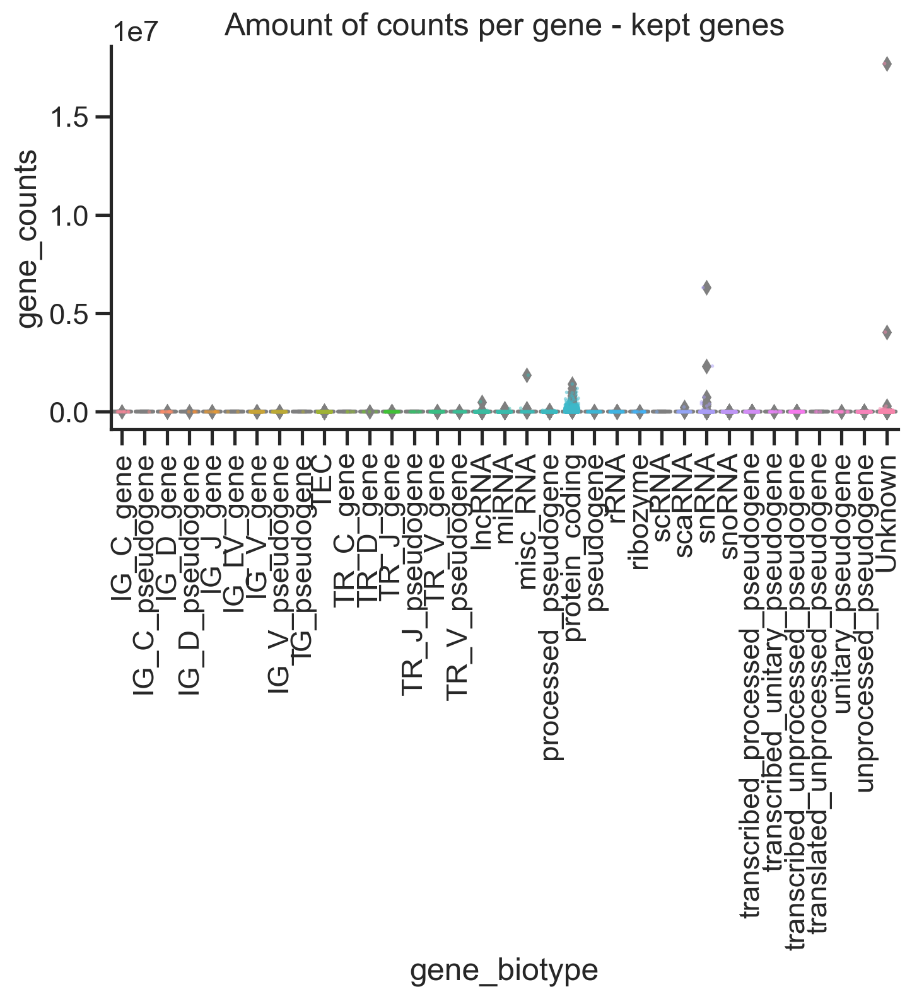

In [53]:
fig, ax = plt.subplots(figsize=(8,4))

sns.boxplot(x = adata[:,keptGenes].var['gene_biotype'], 
            y = adata[:,keptGenes].var['gene_counts'], 
            ax=ax, palette = ['lightgrey'])
plt.legend([])

sns.stripplot(x = adata[:,keptGenes].var['gene_biotype'], 
            y = adata[:,keptGenes].var['gene_counts'],  ax=ax,
              dodge = True, jitter=0.3, marker='o', alpha=0.5, size = 2)
plt.legend([], frameon=False)

sns.despine()
plt.title('Amount of counts per gene - kept genes')
ax.tick_params(axis='x', rotation=90)
#ax.set_ylim([-20,10000])

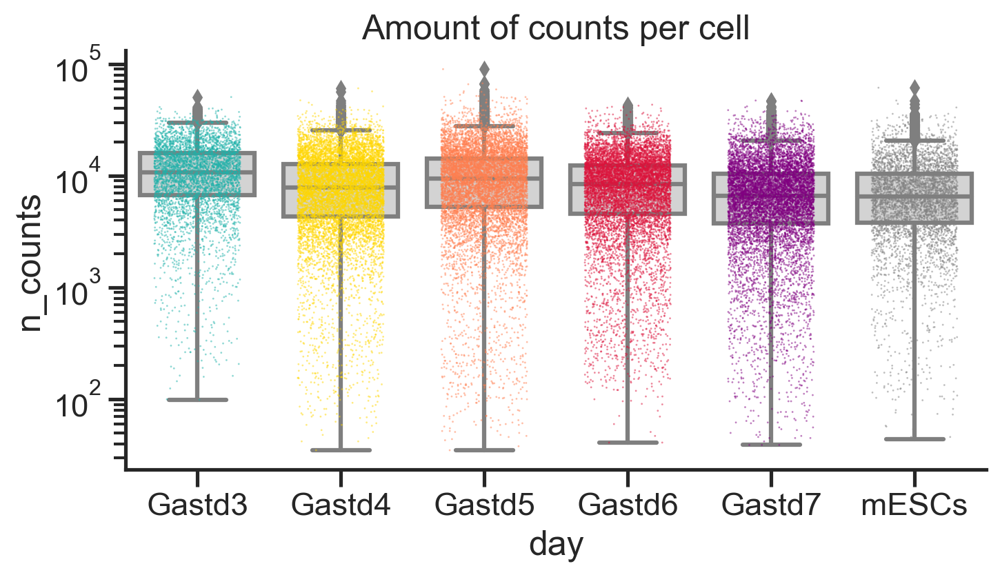

In [54]:
# log scale
fig, ax = plt.subplots(figsize=(8,4))
sns.boxplot(x = adata.obs['day'], y = adata.obs['n_counts'], ax=ax, 
           palette = ['lightgrey','lightgrey','lightgrey','lightgrey'])
plt.legend([])

sns.stripplot(x = adata.obs['day'], y = adata.obs['n_counts'], ax=ax,
            palette = ['lightseagreen','gold','coral','crimson','purple','grey'],#, 'red'],
              dodge = True, jitter=0.3, marker='o', alpha=0.5, size = 1)
plt.legend([], frameon=False)

sns.despine()
plt.title('Amount of counts per cell')
ax.set_yscale('log')

Actually start filtering out cells and genes based on mincount

In [55]:
minCount = 1000
sc.pp.filter_cells(adata, min_counts=minCount)
sc.pp.filter_cells(adata, max_counts=50000)
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=1)

filtered out 2535 cells that have less than 1000 counts
filtered out 19 cells that have more than 50000 counts
filtered out 10154 genes that are detected in less than 1 cells


In [56]:
adata

AnnData object with n_obs × n_vars = 43510 × 43924
    obs: 'batch2', 'batch', 'day', 'replicates', 'mark', 'day_rep', 'dataset', 'cellnames', 'bc', 'cellname', 'percent_mito', 'n_counts', 'n_counts_proteincoding', 'n_counts_stressgenes', 'n_genes'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene', 'gene_biotype', 'gene_counts', 'n_cells'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

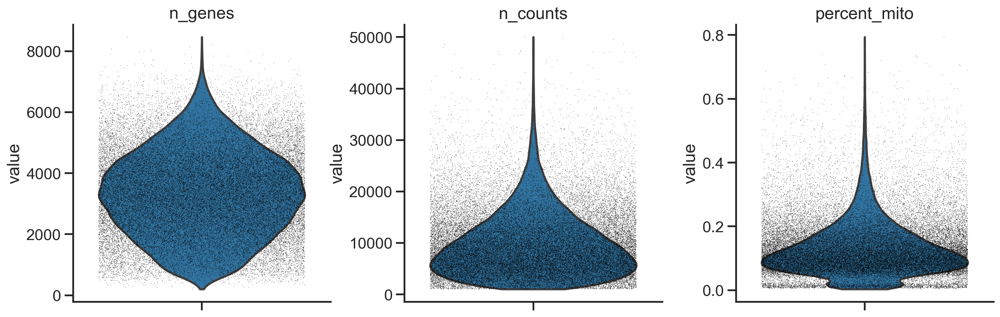

In [57]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],size = 0.5,alpha = 0.5,
             jitter=0.4, multi_panel=True)

Remove cells that have too many mitochondrial genes expressed or too many total counts.

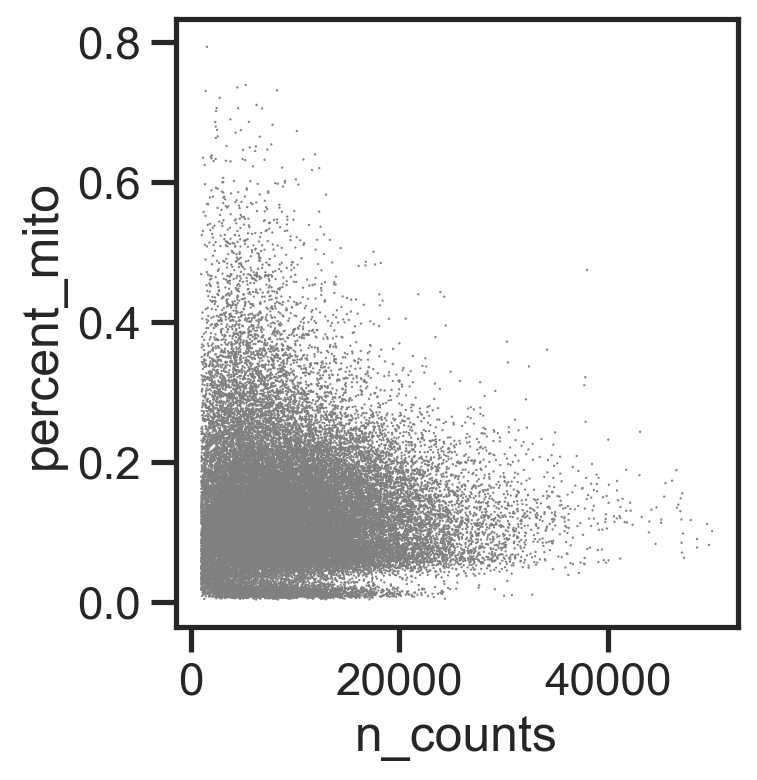

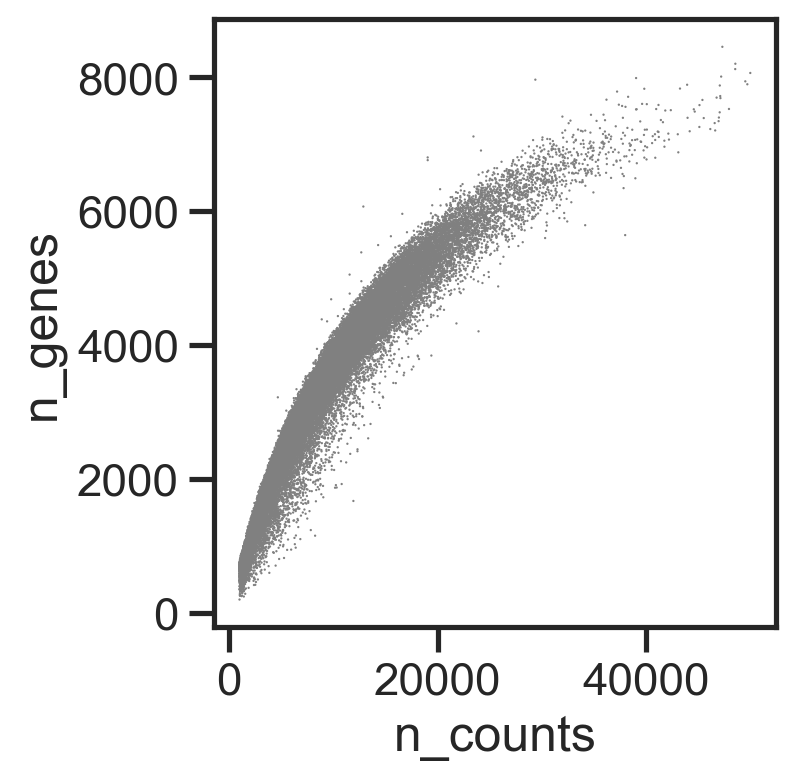

In [58]:
sc.pl.scatter(adata, x='n_counts', y='percent_mito')  
sc.pl.scatter(adata, x='n_counts', y='n_genes')

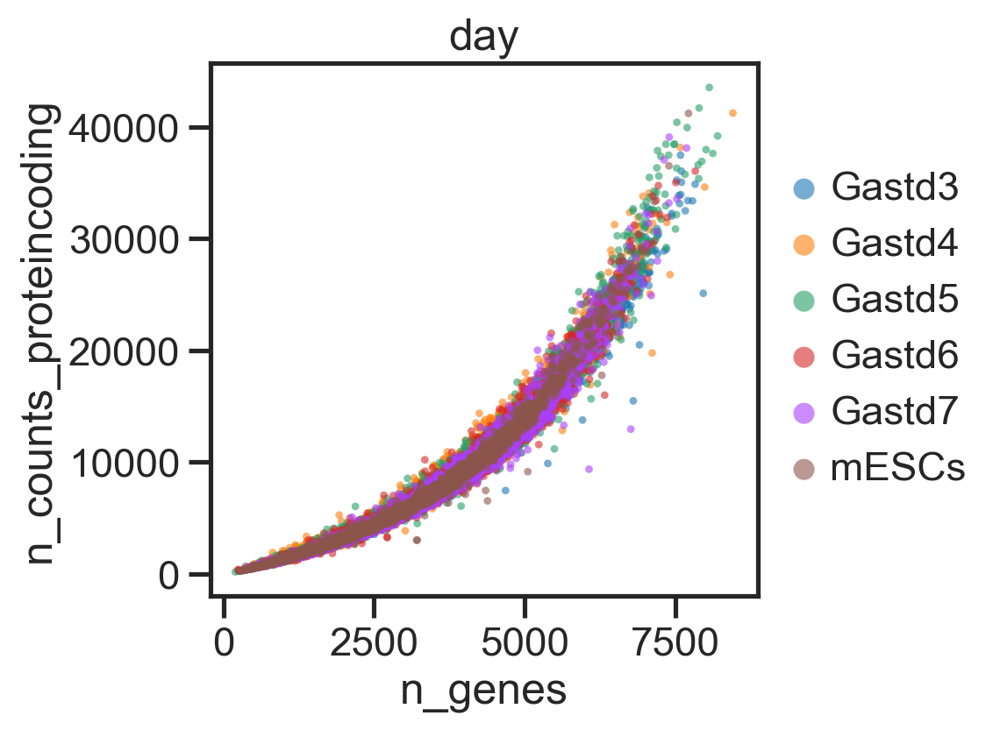

In [59]:
fig, ax = plt.subplots(figsize=(4,4))
sc.pl.scatter(adata, x='n_genes', y='n_counts_proteincoding', color = 'day', ax=ax, alpha = 0.6, size = 40)

Text(0.5, 1.0, 'Amount of counts per cell - per plate')

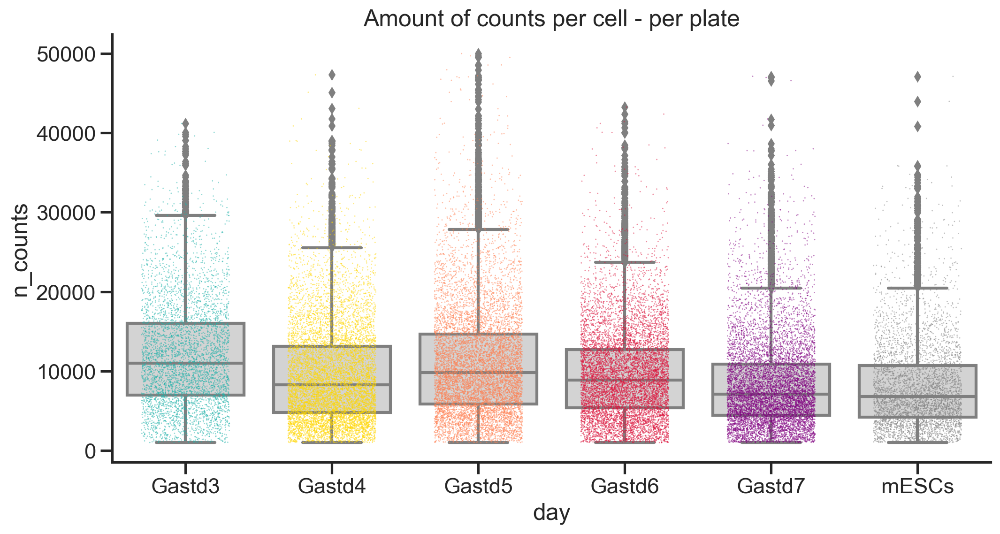

In [60]:
# counts after filtering
# separation per plate, log scale
fig, ax = plt.subplots(figsize=(12,6))
sns.boxplot(x = adata.obs['day'], y = adata.obs['n_counts'], ax=ax, 
           palette = ['lightgrey','lightgrey','lightgrey','lightgrey'])
plt.legend([])

sns.stripplot(x = adata.obs['day'], y = adata.obs['n_counts'], ax=ax,
            palette = ['lightseagreen','gold','coral','crimson','purple','grey'],
              dodge = True, jitter=0.3, marker='o', alpha=0.5, size = 1)
plt.legend([], frameon=False)

sns.despine()
plt.title('Amount of counts per cell - per plate')
#ax.set_yscale('log')

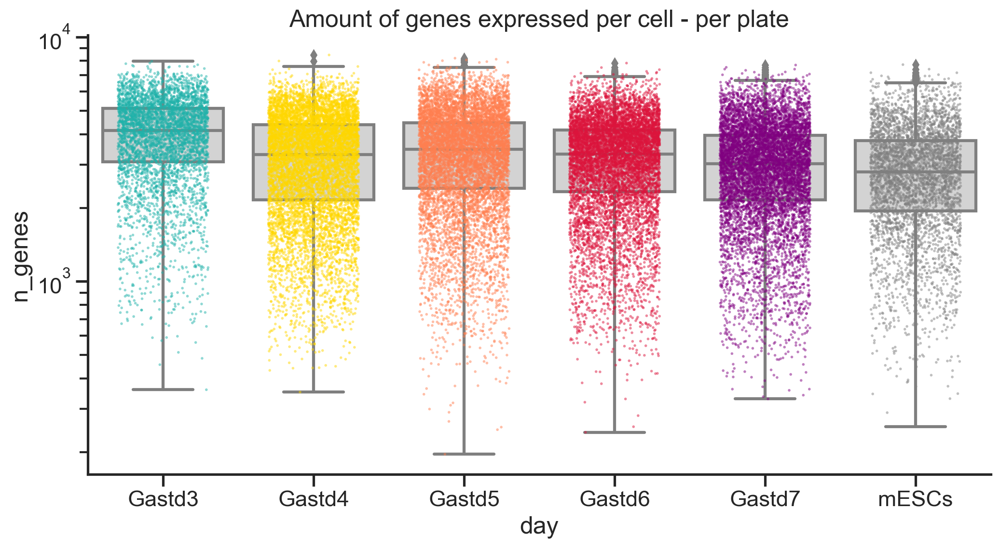

In [61]:
# counts after filtering
# separation per plate, log scale
# amount of genes expressed per cell
fig, ax = plt.subplots(figsize=(12,6))
sns.boxplot(x = adata.obs['day'], y = adata.obs['n_genes'], ax=ax, 
           palette = ['lightgrey','lightgrey','lightgrey','lightgrey'])
plt.legend([])

sns.stripplot(x = adata.obs['day'], y = adata.obs['n_genes'], ax=ax,
            palette = ['lightseagreen','gold','coral','crimson','purple','grey'],
              dodge = True, jitter=0.3, marker='o', alpha=0.5, size = 2)
plt.legend([], frameon=False)

sns.despine()
plt.title('Amount of genes expressed per cell - per plate')
ax.set_yscale('log')

Actually do the filtering.

In [62]:
adata = adata[adata.obs['percent_mito'] < 0.6, :]

throw out any other unwanted genes

In [63]:
# removing genes with annotations we are not interested in
banned = ['NA', 'mt-', "Malat1","Rpl",'Rps','Snor']#'Gm']
keptGenes = [geneName for geneName in adata.var.index if not any( (b in geneName for b in banned) )]
bannedGenes = [geneName for geneName in adata.var.index if any( (b in geneName for b in banned) )]

print('kept: ' + str(len(keptGenes)))
print('banned: ' +str(len(bannedGenes)))

adata = adata[:,keptGenes]

adata

kept: 43691
banned: 233


View of AnnData object with n_obs × n_vars = 43457 × 43691
    obs: 'batch2', 'batch', 'day', 'replicates', 'mark', 'day_rep', 'dataset', 'cellnames', 'bc', 'cellname', 'percent_mito', 'n_counts', 'n_counts_proteincoding', 'n_counts_stressgenes', 'n_genes'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene', 'gene_biotype', 'gene_counts', 'n_cells'
    uns: 'day_colors'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

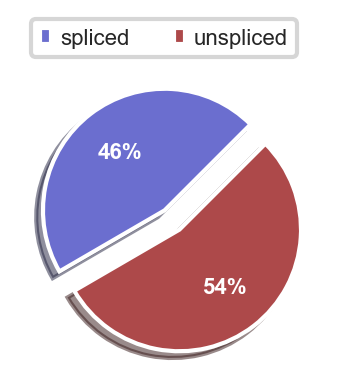

In [64]:
scv.pl.proportions(adata)

#### normalize + logaritgmize the data, check variable genes
Total-count normalize (library-size correct) the data matrix $\mathbf{X}$ to 10,000 reads per cell, so that counts become comparable among cells.

In [65]:
minCount

1000

In [67]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=minCount)

normalizing by total count per cell
    finished (0:01:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


Logarithmize the data.

In [68]:
sc.pp.log1p(adata)

Identify highly-variable genes.

In [69]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:08)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


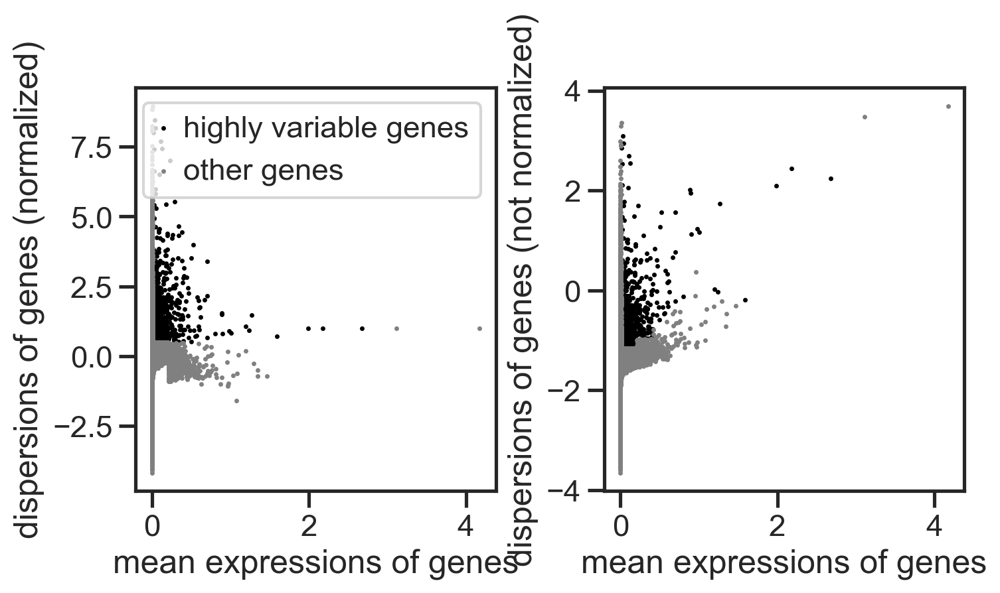

In [70]:
sc.pl.highly_variable_genes(adata)

Set the `.raw` attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object. While many people consider the normalized data matrix as the "relevant data" for visualization and differential testing, some would prefer to store the unnormalized data.

In [71]:
adata.raw = adata

Actually do the filtering.

In [72]:
#adata = adata[:, adata.var['highly_variable']]

Scale each gene to unit variance. Clip values exceeding standard deviation 10. 

In [73]:
sc.pp.scale(adata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


Check and remove effect of histone genes, and check cell cycle

In [74]:
all_cc_genes = read_csv('/Users/m.blotenburg/Documents/Projects/Lianne/2022_Exp_Marloes/jupyter_notebooks/regev_lab_cell_cycle_genes_mouse.csv', index_col=False)
cell_cycle_genes = [x.strip() for x in open('/Users/m.blotenburg/Documents/Projects/Lianne/2022_Exp_Marloes/jupyter_notebooks/regev_lab_cell_cycle_genes.txt')]
s_genes_h = cell_cycle_genes[:43]
g2m_genes_h = cell_cycle_genes[43:]
s_genes = list(all_cc_genes[all_cc_genes['HGNC.symbol'].isin(s_genes_h)]['MGI.symbol'])
g2m_genes = list(all_cc_genes[all_cc_genes['HGNC.symbol'].isin(g2m_genes_h)]['MGI.symbol'])

all_cell_cycle_genes = [x for x in list(all_cc_genes['MGI.symbol']) if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    200 total control genes are used. (0:00:07)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    199 total control genes are used. (0:00:04)
-->     'phase', cell cycle phase (adata.obs)


In [75]:
#sc.set_figure_params(dpi=100, color_map = 'viridis')

computing PCA
    on highly variable genes
    with n_comps=9
    finished (0:00:38)


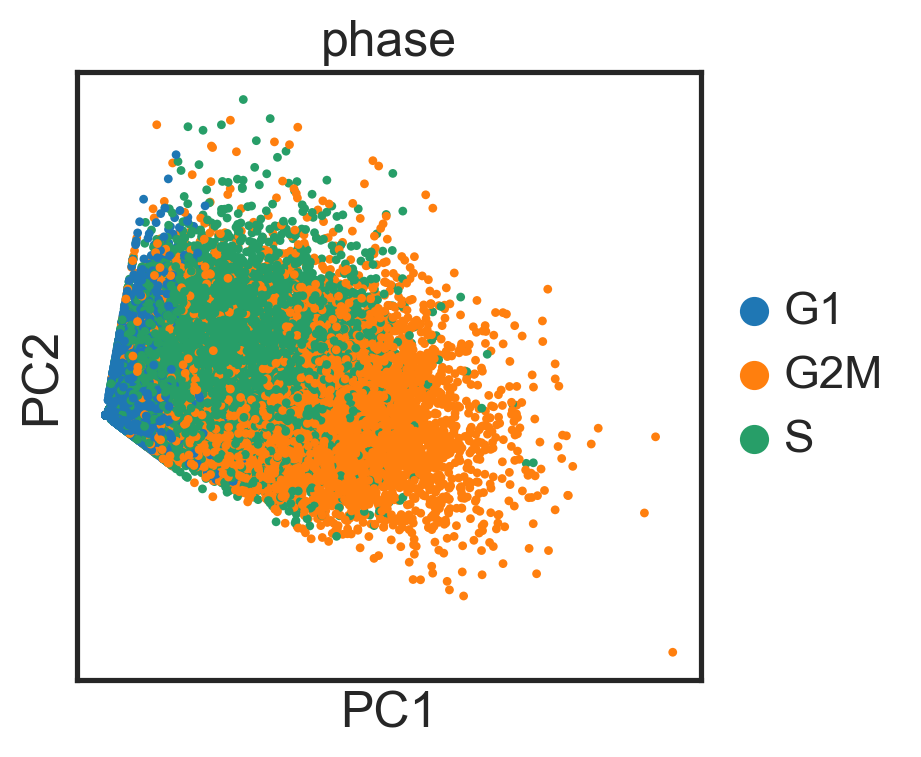

In [76]:
adata_cc_genes = adata[:, all_cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase', size = 40)

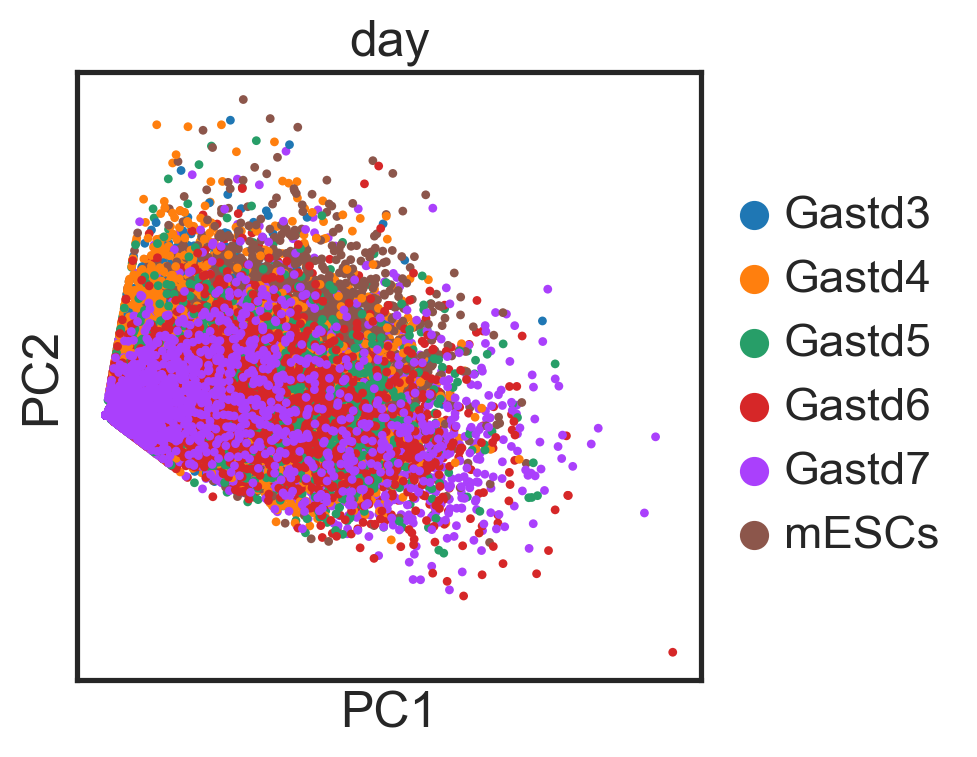

In [77]:
sc.pl.pca_scatter(adata_cc_genes, color='day', size = 40)

In [78]:
histone = adata.var.filter(regex=r'Hist', axis=0).index
len(histone)

65

In [79]:
sc.tl.score_genes(adata, histone, score_name='histone_score', n_bins = 10)

computing score 'histone_score'
    finished: added
    'histone_score', score of gene set (adata.obs).
    450 total control genes are used. (0:00:09)


In [80]:
adata_hist_genes = adata[:, histone]
sc.tl.pca(adata_hist_genes)

computing PCA
    on highly variable genes
    with n_comps=36
    finished (0:00:26)


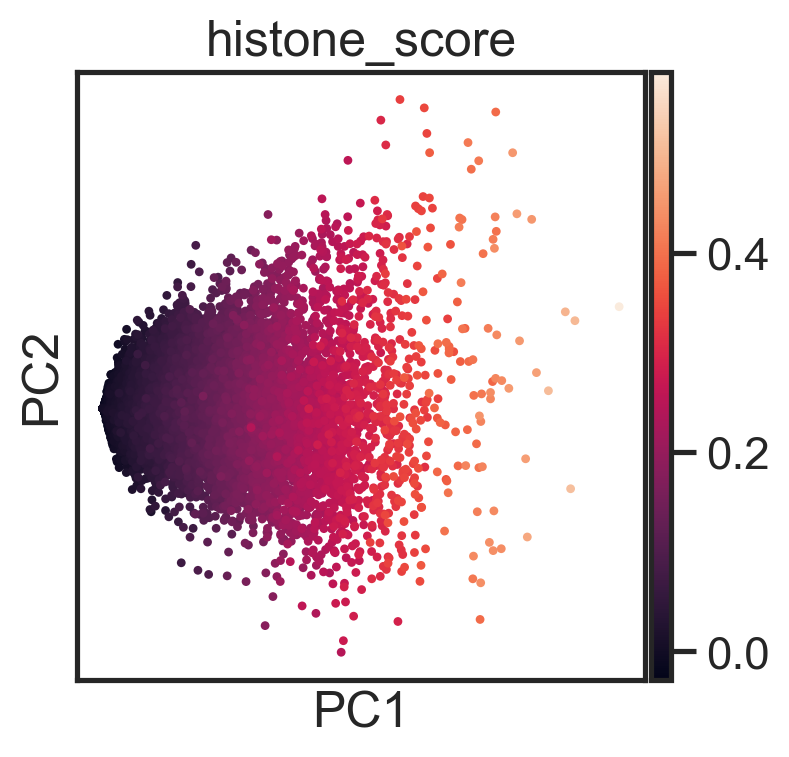

In [81]:
sc.pl.pca_scatter(adata_hist_genes, color='histone_score', size = 40)

Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.

In [82]:
adata.obs['mark_binary'] = pd.get_dummies(adata.obs, columns=['mark'], drop_first=True)['mark_H3K27me3']

In [89]:
sc.pp.regress_out(adata, ['n_counts', 'percent_mito', 'mark_binary'])#, 'histone_score'])

regressing out ['n_counts', 'percent_mito', 'mark_binary']
    finished (1:02:41)


In [90]:
histone2 = adata.var.filter(regex=r'Hist', axis=0).index
adata_hist_genes = adata[:, histone2]



In [91]:
sc.tl.pca(adata_hist_genes)


computing PCA
    on highly variable genes
    with n_comps=36
    finished (0:00:15)


Only keep protein coding and lncRNA

In [92]:
adata = adata[:,list(adata.var.query('gene_biotype == \'lncRNA\' or gene_biotype == \'protein_coding\'').index)]


## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [93]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:04:06)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

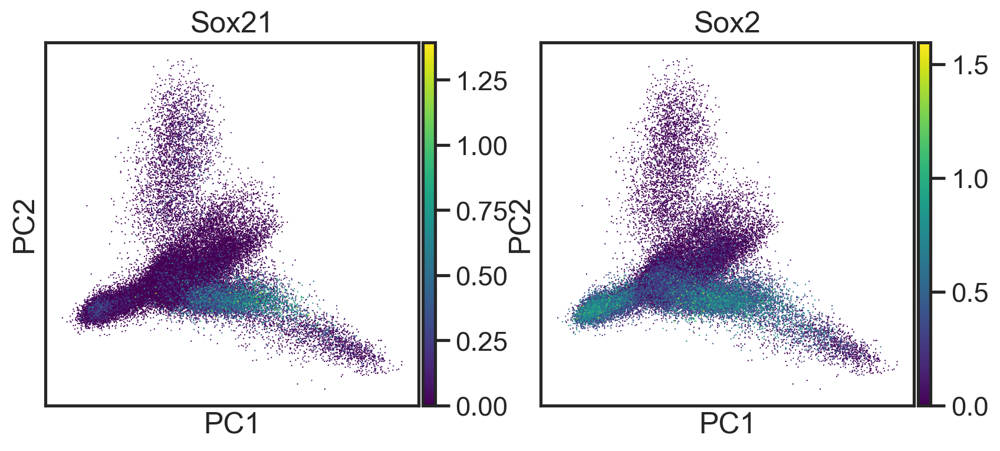

In [94]:
plotgene = [geneName for geneName in adata.var.index if any( (b in geneName for b in ['Sox2']) )]
sc.pl.pca(adata, color=plotgene, color_map = 'viridis')

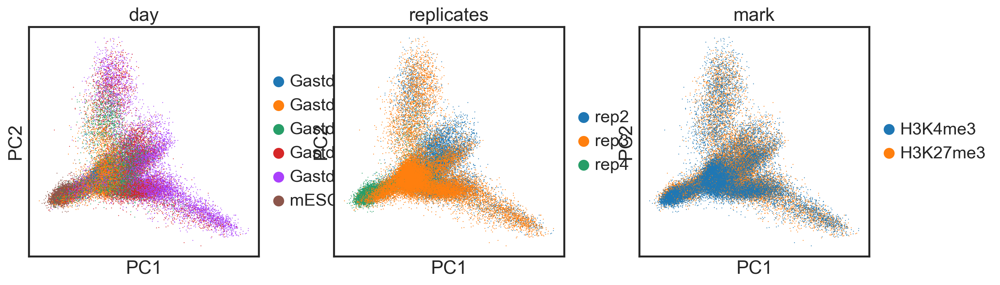

In [95]:
sc.pl.pca(adata, color = ['day', 'replicates','mark'], color_map = 'viridis')

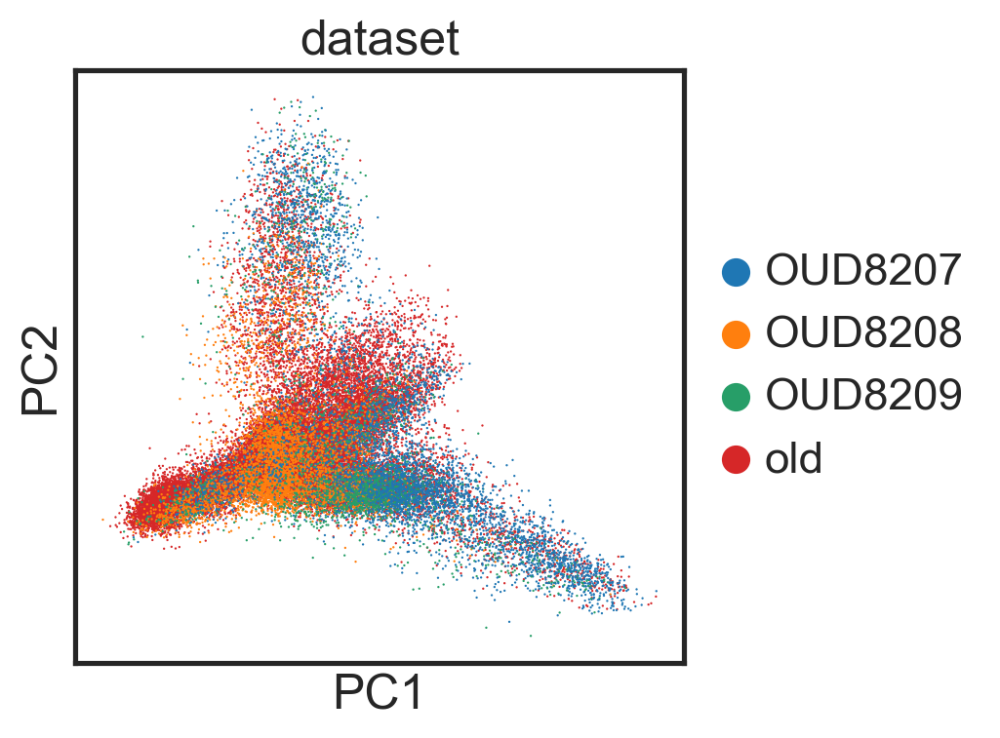

In [96]:
sc.pl.pca(adata, color = ['dataset'], color_map = 'viridis')

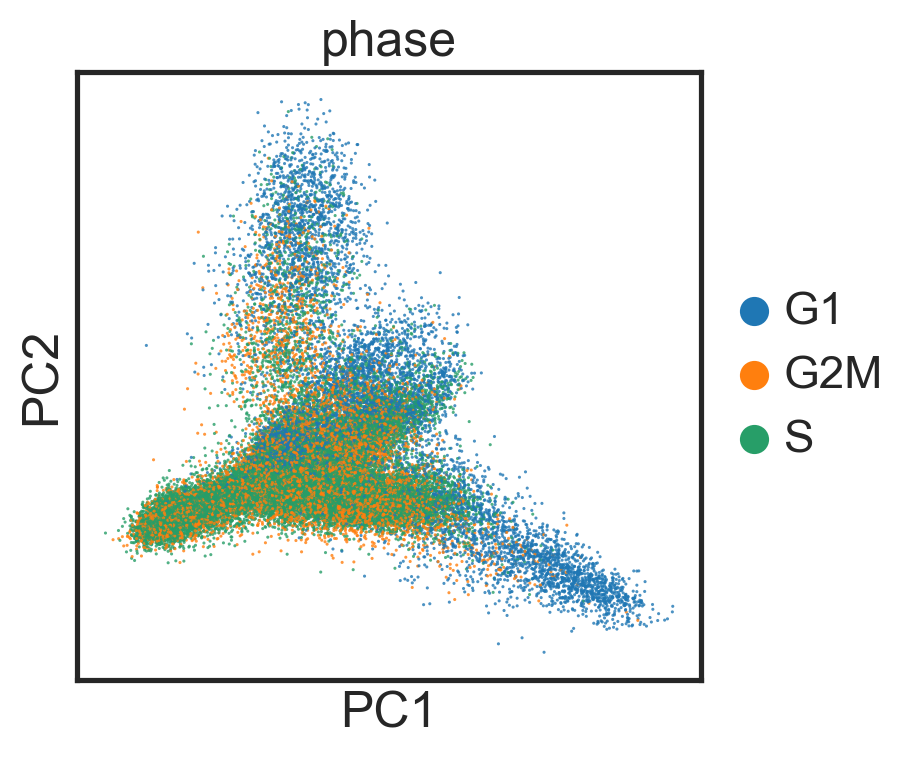

In [97]:
sc.pl.pca(adata, color = ['phase'], size = 5, alpha = 0.8)# components=[ '6,7'])

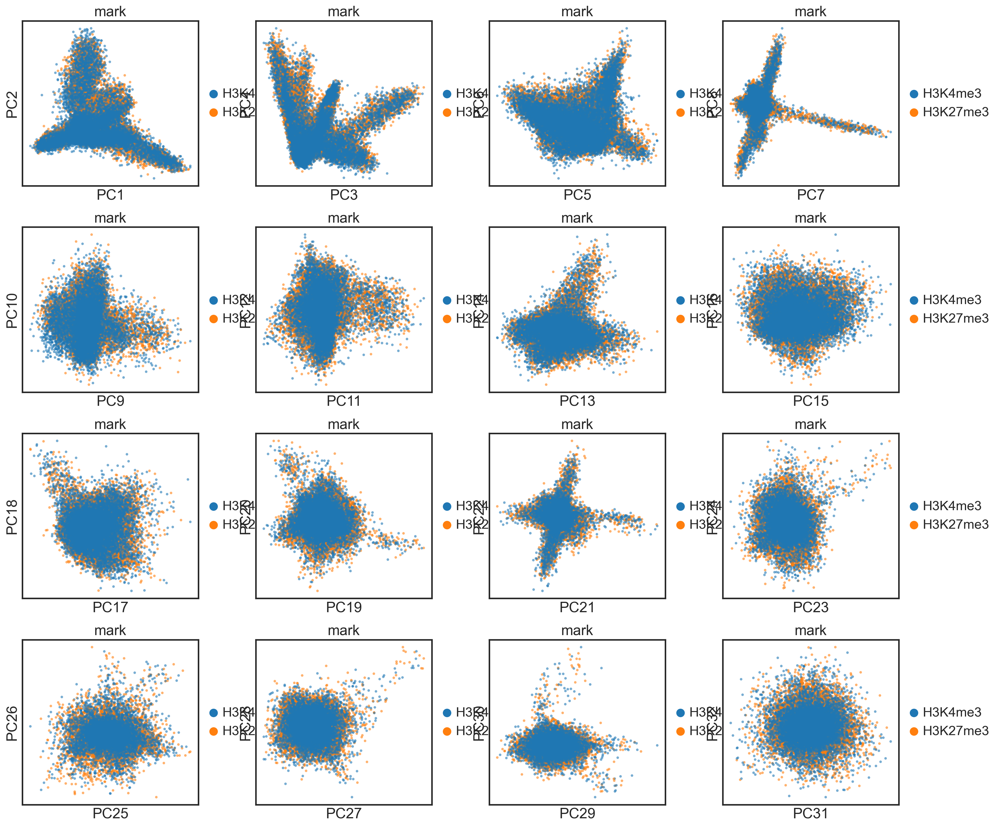

In [99]:
sc.pl.pca_scatter(adata, color='mark', size = 40, components = ['1,2','3,4','5,6','7,8','9,10','11,12','13,14','15,16','17,18','19,20','21,22','23,24','25,26','27,28','29,30','31,32'],alpha=0.6)

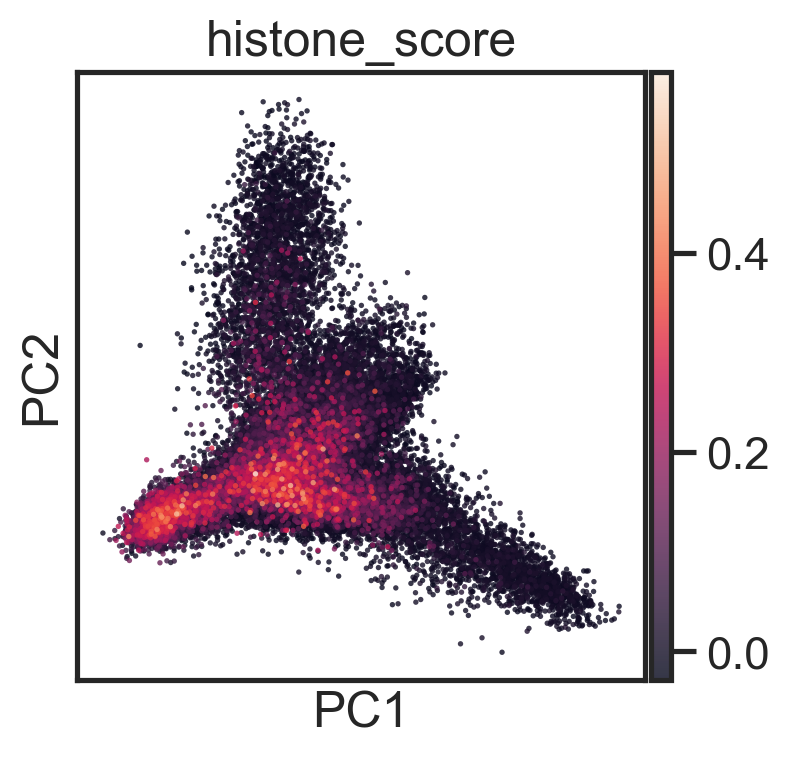

In [100]:
sc.pl.pca(adata, color = ['histone_score'], size = 15, alpha = 0.8)# components=[ '6,7'])

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often, a rough estimate of the number of PCs does fine.

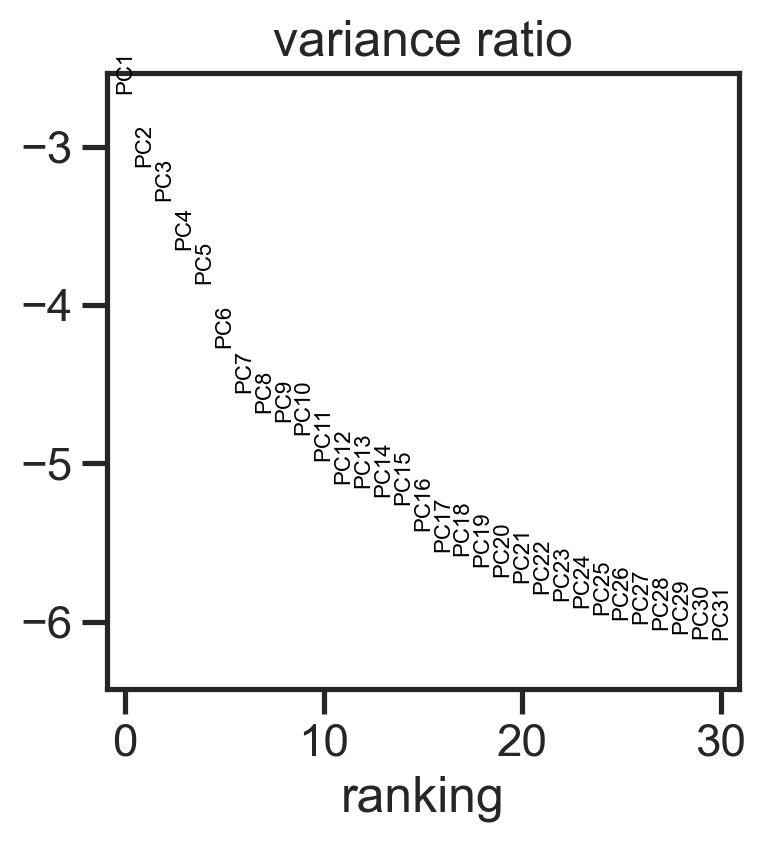

In [101]:
sc.pl.pca_variance_ratio(adata, log=True)

Save the result.

In [102]:
adata.write(results_file)


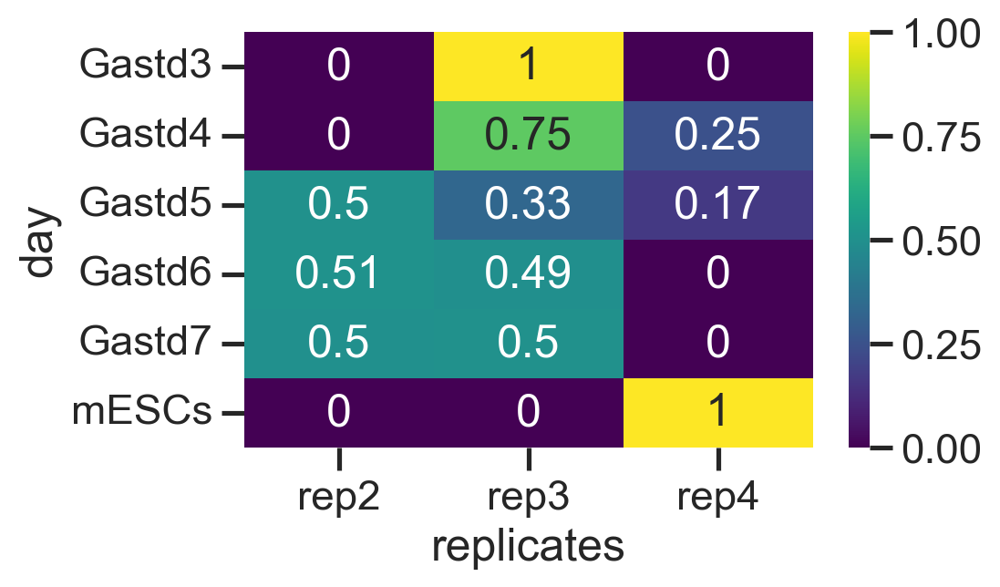

In [103]:
plt.figure(figsize=(5,3))
sns.heatmap(pd.crosstab(adata.obs['day'], adata.obs['replicates'], normalize = 'index'), 
                                     cmap = "viridis",annot = True)
plt.show()

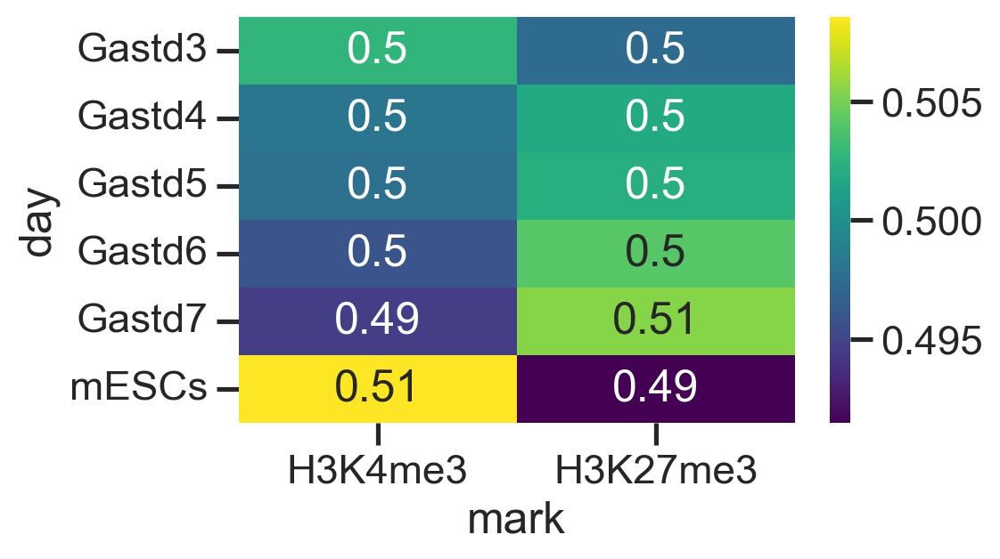

In [114]:
plt.figure(figsize=(5,3))
sns.heatmap(pd.crosstab(adata.obs['day'], adata.obs['mark'], normalize = 'index'), 
                                     cmap = "viridis",annot = True)
plt.show()

In [105]:
PCs = pd.DataFrame(adata.varm['PCs'])
PCs.index = adata.var.index
PCs

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
Gene,,,,,,,,,,,,,,,,,,,,,
Xkr4,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
Gm37381,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
Rp1,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
Sox17,-0.004421,0.074726,0.040717,-0.025243,-0.01679,-0.031944,0.03444,0.012509,-0.048797,-0.023345,...,-0.009037,-0.032672,0.02305,0.004238,0.00034,0.028407,-0.001219,0.017918,0.047042,-0.030597
Gm37323,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Gm20820,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
Gm28365,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
Gm28367,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000


In [113]:
len(adata.obs['batch'].unique())

120

In [110]:
PCs.to_csv('20230619_PCs_genes.csv')

In [107]:
adata.varm['PCs'].shape

(27384, 50)

In [108]:
pwd

'/Users/m.blotenburg/Documents/Projects/TCHIC/data/jupyter_notebooks/2023'

In [109]:
PC2s = pd.DataFrame(adata.obsm['X_pca'])
PC2s.index = adata.obs.index
PC2s.head(2)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
index,,,,,,,,,,,,,,,,,,,,,
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_341,0.964806,7.191636,-2.603930,9.105891,3.938356,1.973699,21.090298,-4.302753,-2.225135,-3.084515,...,-1.750981,-0.541662,-0.878853,-0.083634,-0.985140,0.722176,0.712043,-2.020363,0.711821,0.820616
PZ-MB-TChIC-Gastd5-rep2-H3K27me3-1_310,1.116417,-3.545411,-4.362295,-2.500739,-1.401487,-2.550253,0.541622,-1.592143,0.898946,-1.456221,...,-0.618513,-0.441833,-0.222073,-0.648918,1.155977,-0.026675,0.049775,0.415757,0.558149,-0.210710


In [111]:
PC2s.to_csv('20230619_PCs_cells.csv')